# Generate two sets of random number using congruential method say x1 and x2 and then
find y1 = (-2ln*x1) ^ 1/2 cos(2*pie*x1)
y2 = (-2ln*x1) ^ 1/2 sin(2*pie * x2)

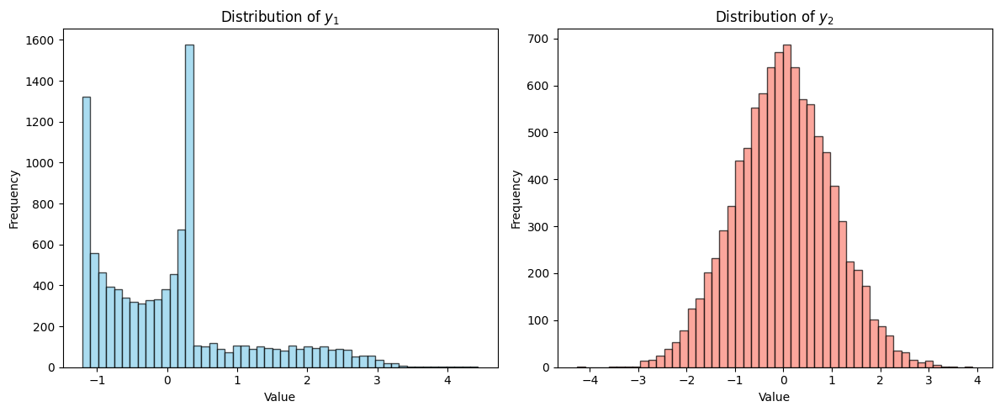

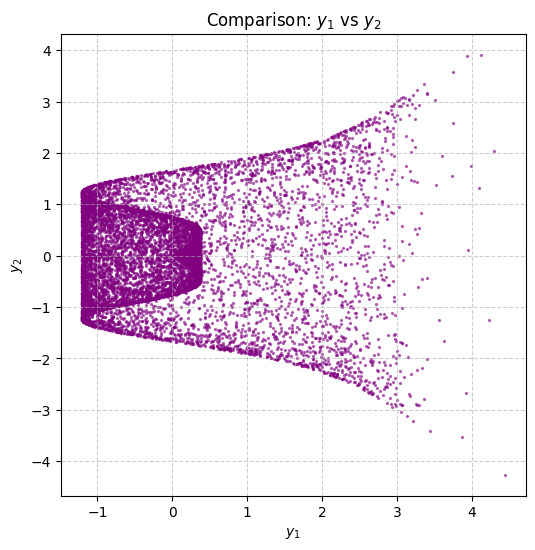

Statistical Comparison:
Number of samples: 10000
Statistics for x1: Mean = 0.5006, Std Dev = 0.2890
Statistics for x2: Mean = 0.4959, Std Dev = 0.2877
Statistics for y1: Mean = 0.0570, Std Dev = 1.0519
Statistics for y2: Mean = 0.0086, Std Dev = 0.9976


In [6]:
import numpy as np
import matplotlib.pyplot as plt

def lcg(seed, n, a=1664525, c=16807, m=2**31-1):
    """
    Linear Congruential Generator to produce uniform random numbers in [0, 1).
    """
    numbers = []
    current = seed
    for _ in range(n):
        current = (a * current + c) % m
        numbers.append(current / m)

    return np.array(numbers)

# 1. Generate two sets of random numbers x1 and x2
N = 10000
x1 = lcg(seed=42, n=N)
x2 = lcg(seed=123, n=N)

# Avoid log(0) by ensuring no value is exactly zero
x1 = np.clip(x1, 1e-10, 1.0)

# 2. Calculate y1 and y2 based on the provided formulas
# y1 = (-2 * ln(x1))^1/2 * cos(2 * pi * x1)
# y2 = (-2 * ln(x1))^1/2 * sin(2 * pi * x2)
y1 = np.sqrt(-2 * np.log(x1)) * np.cos(2 * np.pi * x1)
y2 = np.sqrt(-2 * np.log(x1)) * np.sin(2 * np.pi * x2)

# 3. Plot the data
plt.figure(figsize=(12, 5))

# Plot Histogram for y1
plt.subplot(1, 2, 1)
plt.hist(y1, bins=50, color='skyblue', edgecolor='black', alpha=0.7)
plt.title(r'Distribution of $y_1$')
plt.xlabel('Value')
plt.ylabel('Frequency')

# Plot Histogram for y2
plt.subplot(1, 2, 2)
plt.hist(y2, bins=50, color='salmon', edgecolor='black', alpha=0.7)
plt.title(r'Distribution of $y_2$')
plt.xlabel('Value')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

# 4. Scatter Plot to compare y1 and y2
plt.figure(figsize=(6, 6))
plt.scatter(y1, y2, s=2, alpha=0.5, color='purple')
plt.title(r'Comparison: $y_1$ vs $y_2$')
plt.xlabel('$y_1$')
plt.ylabel('$y_2$')
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()

# 5. Statistical Comparison
print("Statistical Comparison:")
print(f"Number of samples: {N}")
print(f"Statistics for x1: Mean = {np.mean(x1):.4f}, Std Dev = {np.std(x1):.4f}")
print(f"Statistics for x2: Mean = {np.mean(x2):.4f}, Std Dev = {np.std(x2):.4f}")
print(f"Statistics for y1: Mean = {np.mean(y1):.4f}, Std Dev = {np.std(y1):.4f}")
print(f"Statistics for y2: Mean = {np.mean(y2):.4f}, Std Dev = {np.std(y2):.4f}")

In [7]:
print("Statistical Comparison:")
print(f"Number of samples: {N}")

Statistical Comparison:
Number of samples: 10000


Calculating C_1
i=0, x1[i]=0.032562230263167166, x1[i+k]=0.6463366246998015
i=1, x1[i]=0.6463366246998015, x1[i+k]=0.4702362634568644
i=2, x1[i]=0.4702362634568644, x1[i+k]=0.01643836359327583
i=3, x1[i]=0.01643836359327583, x1[i+k]=0.0671679238170236
i=4, x1[i]=0.0671679238170236, x1[i+k]=0.6883993575761091
i=5, x1[i]=0.6883993575761091, x1[i+k]=0.9406771994850958
i=6, x1[i]=0.9406771994850958, x1[i+k]=0.7154807554164346
i=7, x1[i]=0.7154807554164346, x1[i+k]=0.6044173671884543
i=8, x1[i]=0.6044173671884543, x1[i+k]=0.8181271882812153
i=9, x1[i]=0.8181271882812153, x1[i+k]=0.15808161634862497
i=10, x1[i]=0.15808161634862497, x1[i+k]=0.8024605213675929
i=11, x1[i]=0.8024605213675929, x1[i+k]=0.5993372190740598
i=12, x1[i]=0.5993372190740598, x1[i+k]=0.7845870758335046
i=13, x1[i]=0.7845870758335046, x1[i+k]=0.8024095905955926
i=14, x1[i]=0.8024095905955926, x1[i+k]=0.823793955065214
i=15, x1[i]=0.823793955065214, x1[i+k]=0.6330627517928662
i=16, x1[i]=0.6330627517928662, x1[i+k]=0.7769

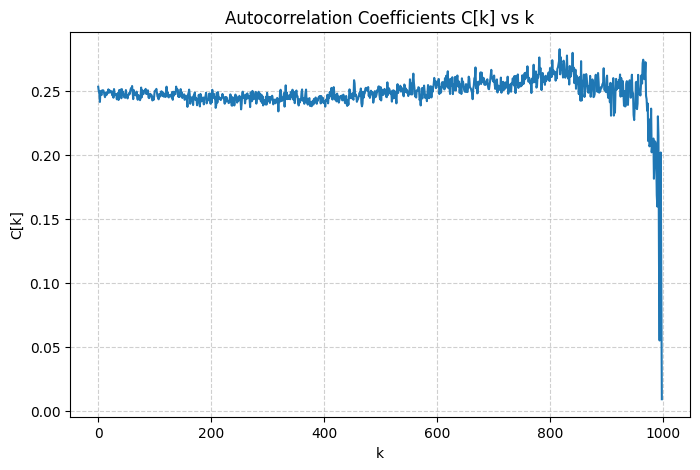

In [ ]:
# Autocorrelation Calculation for x1
N = 1000
# k = 1

x1 = lcg(seed=42, n=N)
# print(x1)

#  store the correlation coefficients for every k
Ck_values = []
Ck_normalized_values = []

for k in range(1, N):
    # print(f"Calculating C_{k}")
    sum_xy = 0
    for i in range(N-k):
        # print(f"i={i}, x1[i]={x1[i]}, x1[i+k]={x1[i+k]}")
        sum_xy += x1[i] * x1[i+k]
        # print(f"Intermediate sum_xy: {sum_xy}")

        # compute Ck

    Ck = sum_xy / (N - k)
    Ck_values.append(Ck)

    #  normalized Ck
    mean_x1 = np.mean(x1)
    Ck_normalized = (Ck - mean_x1**2) / (np.var(x1))
    Ck_normalized_values.append(Ck_normalized)
    # print(f"Correlation coefficient C_{k} for x1: {Ck}")

print("Autocorrelation Coefficients:", Ck_values)
# plot the Ck_values against k
plt.figure(figsize=(8, 5))
# plt.stem(range(1, N), Ck_values)
plt.plot(Ck_values)

plt.title('Autocorrelation Coefficients C[k] vs k')
plt.xlabel('k')
plt.ylabel('C[k]')
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()